In [1]:
from token_tensor import token_embd
from learned import total_embeddings_learned
from sinusoidal import total_embeddings_sinusoidal

In [2]:
token_embd-=token_embd.mean(dim=0,keepdim=True)
total_embeddings_learned-=total_embeddings_learned.mean(dim=0,keepdim=True)
total_embeddings_sinusoidal-=total_embeddings_sinusoidal.mean(dim=0,keepdim=True)

In [3]:
from sklearn.decomposition import PCA

In [4]:
token_embd=token_embd.detach().cpu().numpy()
total_embeddings_learned=total_embeddings_learned.detach().cpu().numpy()
total_embeddings_sinusoidal=total_embeddings_sinusoidal.detach().cpu().numpy()

In [5]:
pca=PCA(n_components=3)
pca_n=pca.fit_transform(token_embd)
pca_l=pca.fit_transform(total_embeddings_learned)
pca_s=pca.fit_transform(total_embeddings_sinusoidal)

In [6]:
T=pca_s.shape[0]

In [7]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation



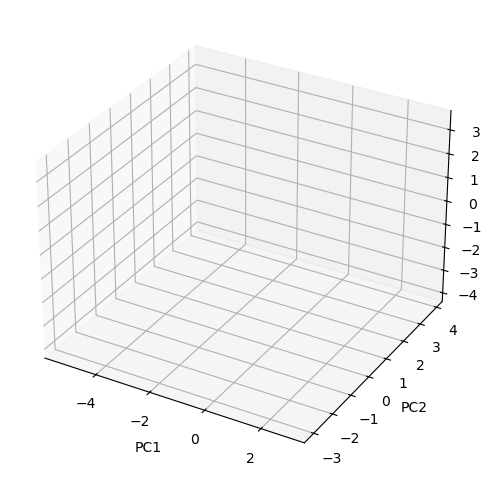

In [8]:
fig = plt.figure(figsize=(6, 6))
ax = fig.add_subplot(111, projection="3d")

ax.set_xlim(pca_s[:,0].min(), pca_s[:,0].max())
ax.set_ylim(pca_s[:,1].min(), pca_s[:,1].max())
ax.set_zlim(pca_s[:,2].min(), pca_s[:,2].max())

ax.set_xlabel("PC1")
ax.set_ylabel("PC2")
ax.set_zlabel("PC3")

line, = ax.plot([], [], [], lw=2)
points = ax.scatter([], [], [], s=30)


In [9]:
def update(frame):
    line.set_data(pca_s[:frame, 0], pca_s[:frame, 1])
    line.set_3d_properties(pca_s[:frame, 2])
    
    points._offsets3d = (
        pca_s[:frame, 0],
        pca_s[:frame, 1],
        pca_s[:frame, 2],
    )
    return line, points


In [10]:
ani = FuncAnimation(
    fig,
    update,
    frames=T,
    interval=100,
    blit=False
)

ani



In [11]:
from IPython.display import HTML
HTML(ani.to_jshtml())


Animation size has reached 20975910 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
